In [ ]:
import numpy as np
import os
import matplotlib.pyplot as plt
import matplotlib
import scipy.stats
import pandas as pd
from scipy.io import loadmat
from utils import default_paths, prf_utils, nsd_utils
from model_fitting import initialize_fitting
from feature_extraction import fwrf_features

In [ ]:
cluster_fn = os.path.join('/user_data/mmhender/toolboxes/SketchTokens/', 'clusters.mat')
clust = loadmat(cluster_fn)
feature_ims = clust['clusters']['clusters'][0][0]
feature_ims = np.moveaxis(feature_ims, [0,1,2], [1,0,2])

In [ ]:
fn = os.path.join(default_paths.sketch_token_feat_path,\
                  'Sketch_token_feature_curvrect_stats.npy')
stats = np.load(fn, allow_pickle=True).item()
c_means1 = np.mean(np.mean(stats['curv_score_method1'], axis=0), axis=0)
l_means1 = np.mean(np.mean(stats['lin_score_method1'], axis=0), axis=0)

curv_score = scipy.stats.zscore(c_means1)
lin_score = scipy.stats.zscore(l_means1)

In [ ]:
dfname = os.path.join(default_paths.sketch_token_feat_path, \
                      'Sketch_tokens_info_table.csv')
df = pd.read_csv(dfname)

estim_bend_values = np.array(df['best_bend'])
estim_orient_values = np.array(df['best_orient']*180/np.pi)
best_linear_index = np.array(df['best_linear_index'])
best_curv_index = np.array(df['best_curv_index'])
which_best = np.array(df['which_best'])

is_single = df['single']
is_junction = df['junction']
is_double = df['double']
is_other = df['other']

In [73]:
prf_models = initialize_fitting.get_prf_models(which_grid=5)
angle, eccen = prf_utils.cart_to_pol(prf_models[:,0]*8.4, prf_models[:,1]*8.4)
angle = np.round(angle,1)
eccen = np.round(eccen,2)
size = np.round(prf_models[:,2]*8.4,2)
aa = np.unique(angle)[14];
ee = np.unique(eccen)[3];
# ss = np.unique(size)[4];
ss = np.unique(size)[0];
mm = np.where((angle==aa) & (eccen==ee) & (size==ss))[0][0]
mm

62

In [58]:
mm = 378

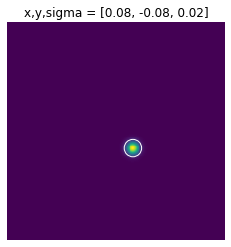

In [74]:
x,y,sigma = prf_models[mm,:]
n_pix = 240
prf_2d = prf_utils.gauss_2d(center=[x,y], sd=sigma, patch_size=n_pix)


plt.figure();
ax = plt.subplot(1,1,1)
plt.pcolormesh(prf_2d)
plt.axis('off')
plt.axis('square')
plt.gca().invert_yaxis()
plt.title('x,y,sigma = [%.2f, %.2f, %.2f]'%(x,y,sigma));

center_in_image = np.array((n_pix/2 + x*n_pix, n_pix/2 - n_pix*y))
size_in_image = 2*sigma*n_pix
circ = matplotlib.patches.Circle(center_in_image, size_in_image, 
                                                 color = 'w', fill=False)
ax.add_artist(circ)

In [75]:
subject =1
which_prf_grid=5
feat_loader = fwrf_features.fwrf_feature_loader(subject=subject,\
                                which_prf_grid=which_prf_grid, \
                                feature_type='sketch_tokens',\
                                use_pca_feats = False, prf_batch_size=1)
inds_load = np.arange(1000) 
feat, _ = feat_loader.load(inds_load, prf_model_index=mm)

Loading pre-computed features for models [62 - 62] from /user_data/mmhender/features/sketch_tokens/S1_features_each_prf_grid5.h5py
Took 1.56941 seconds to load file
Size of features array for this image set is:
(1000, 150, 1)
Index into batch for prf 62: 0
Size of features array for this image set and prf is:
(1000, 150)
Final size of feature matrix is:
(1000, 150)


In [76]:
image_data = nsd_utils.get_image_data(subject)
image_data = image_data[inds_load,:,:,:]
image_data = nsd_utils.image_uncolorize_fn(image_data)


Loading images for subject 1

image data size: (10000, 3, 240, 240) , dtype: uint8 , value range: 0 255


In [47]:
import h5py
hdf5_file = os.path.join(default_paths.sketch_token_feat_path, 'S%d_edges_240.h5py'%subject)
data_set = h5py.File(hdf5_file, 'r')
keyname = list(data_set.keys())[0]
values = np.copy(data_set[keyname])
data_set.close() 

In [51]:
edge_data = values[:,:,inds_load]
edge_data.shape

(240, 240, 1000)

In [81]:
def plot_top_ims(features_to_plot, top_n=5):

    center_in_image = np.array((n_pix/2 + x*n_pix, n_pix/2 - n_pix*y))
    size_in_image = 2*sigma*n_pix

    for fi, ff in enumerate(features_to_plot):

        zvals = scipy.stats.zscore(feat[:,ff])
        top_image_inds = np.flip(np.argsort(zvals))[0:top_n]
        top_images = image_data[top_image_inds,0,:,:]
        top_edge_maps = edge_data[:,:,top_image_inds]

        plt.figure(figsize=(16,8));
        plt.subplot(2,6,1)
        plt.pcolormesh(feature_ims[:,:,ff])
        plt.axis('square')
        plt.gca().invert_yaxis()
        plt.axis('off')

        for ii in range(top_n):
            ax = plt.subplot(2,6,ii+2);
            plt.imshow(top_images[ii,:,:])
            circ = matplotlib.patches.Circle(center_in_image, size_in_image, 
                                                         color = 'w', fill=False)
            ax.add_artist(circ)
            plt.axis('off')
            
        for ii in range(top_n):
            ax = plt.subplot(2,6,ii+2+6);
            plt.imshow(top_edge_maps[:,:,ii])
            circ = matplotlib.patches.Circle(center_in_image, size_in_image, 
                                                         color = 'w', fill=False)
            ax.add_artist(circ)
            plt.axis('off')

        plt.suptitle('feature %d, bend=%.4f, orient=%d, curv score=%.2f, lin score=%.2f'%(ff, \
            estim_bend_values[ff], estim_orient_values[ff], curv_score[ff], lin_score[ff]))

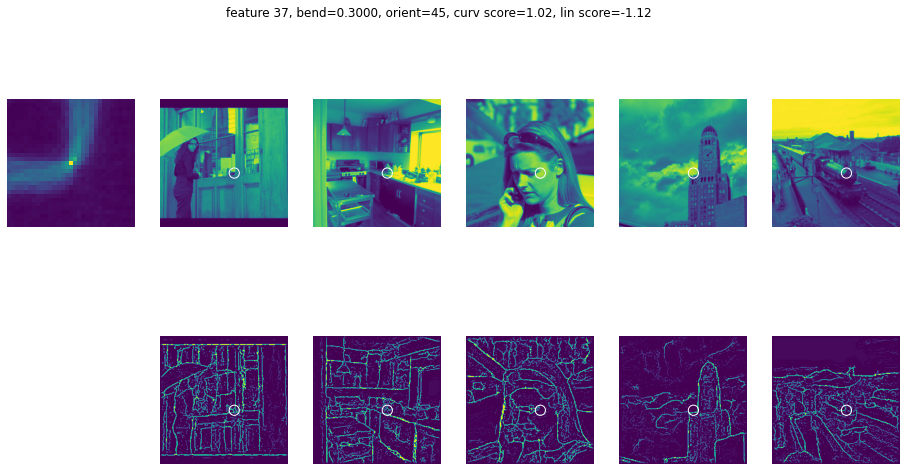

In [82]:
features_to_plot = [37]
plot_top_ims(features_to_plot, top_n=5)

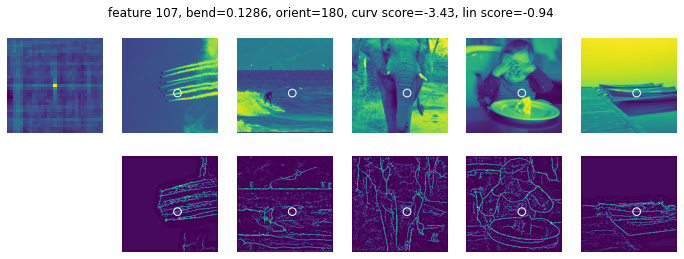

In [79]:
features_to_plot = [107]
plot_top_ims(features_to_plot)

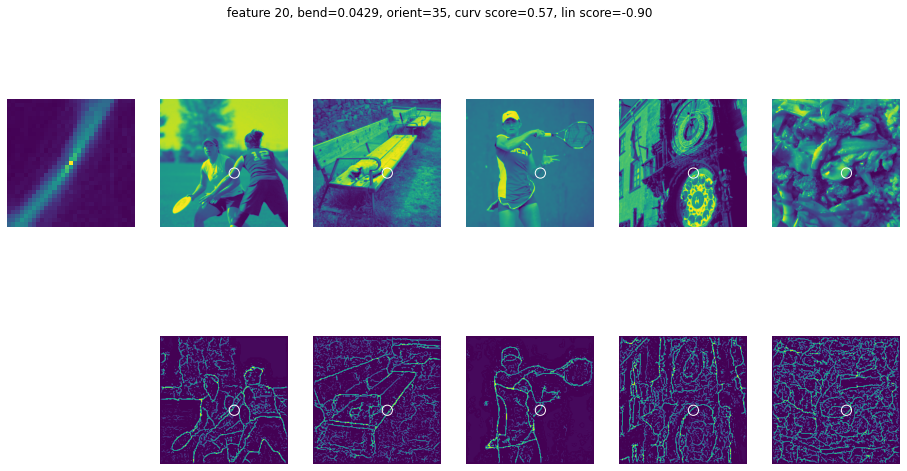

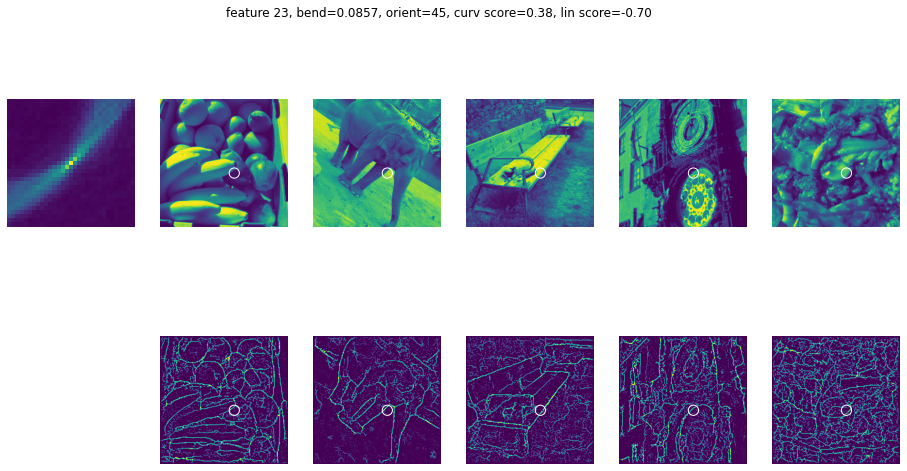

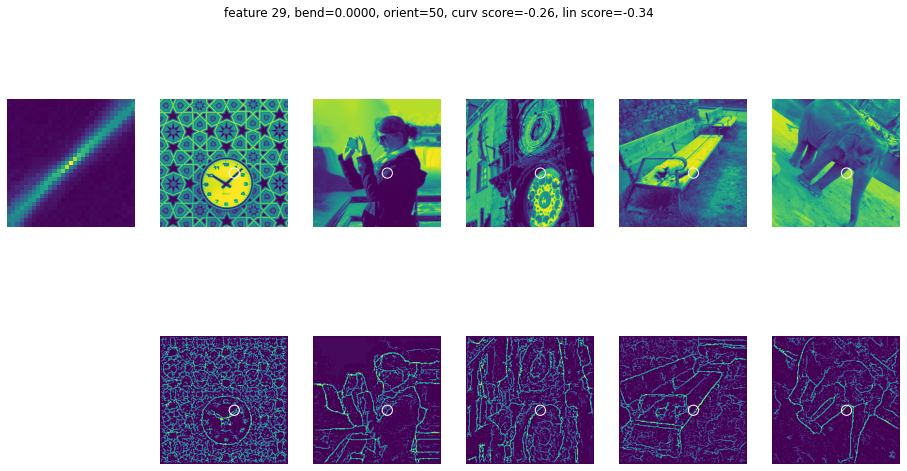

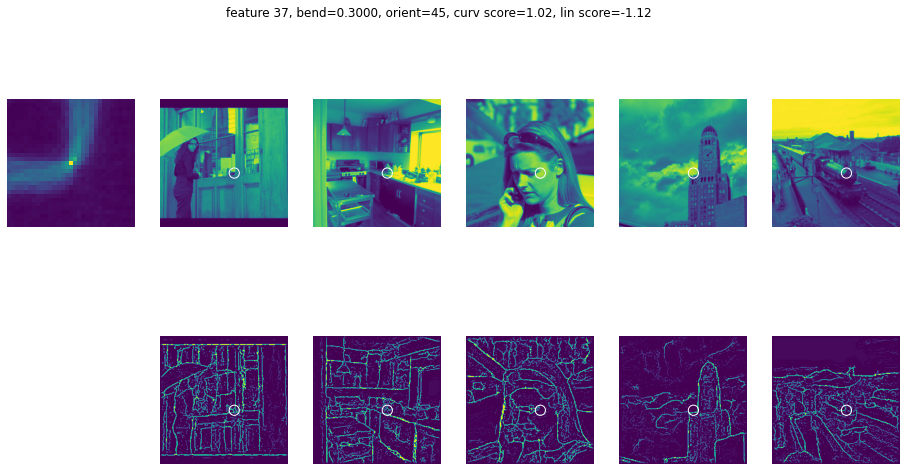

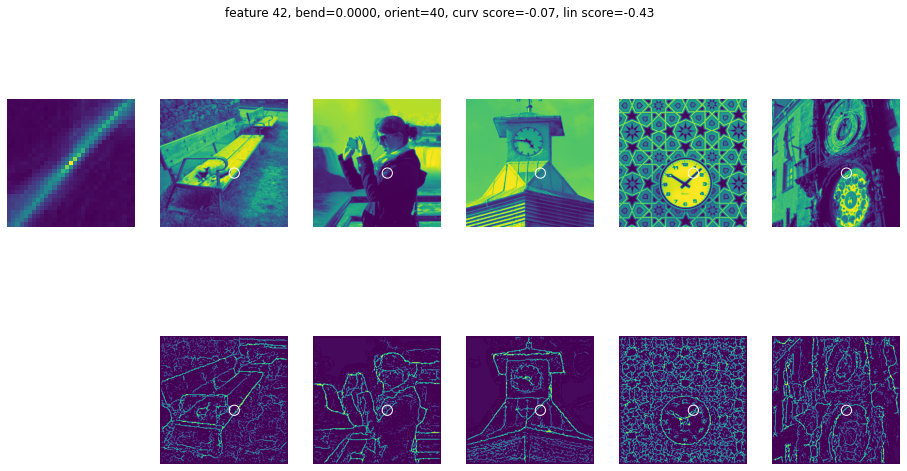

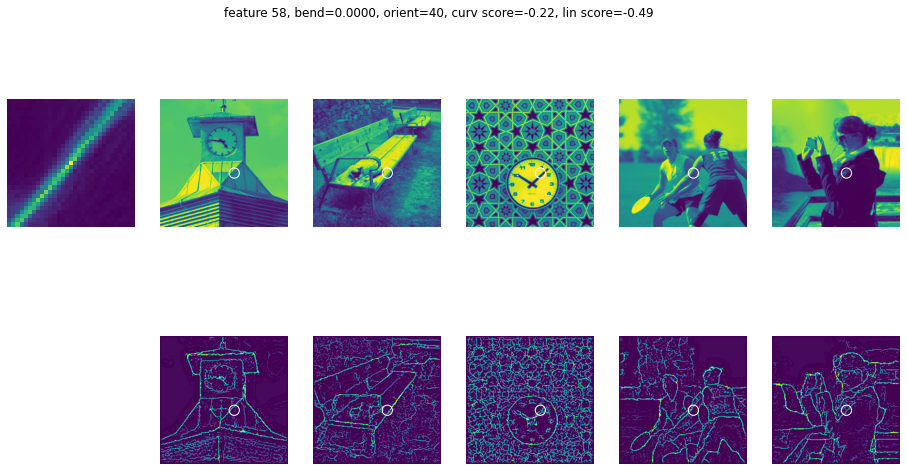

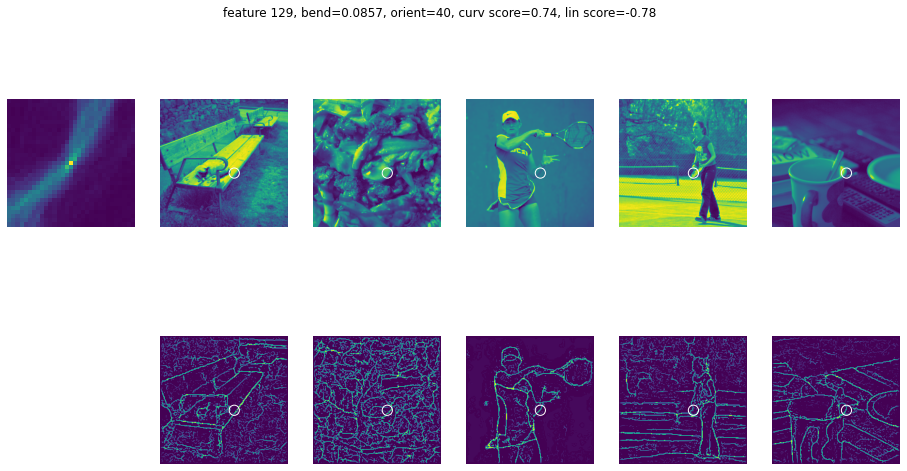

In [83]:
features_to_plot = np.where(np.abs(estim_orient_values-45)<=10)[0]
plot_top_ims(features_to_plot)

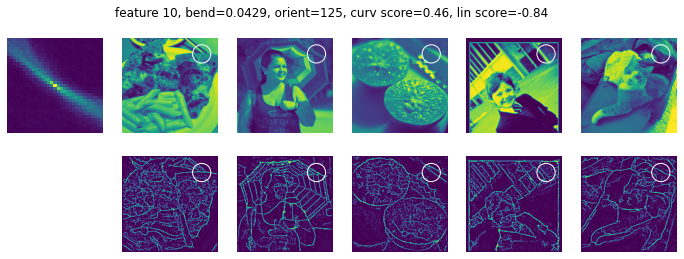

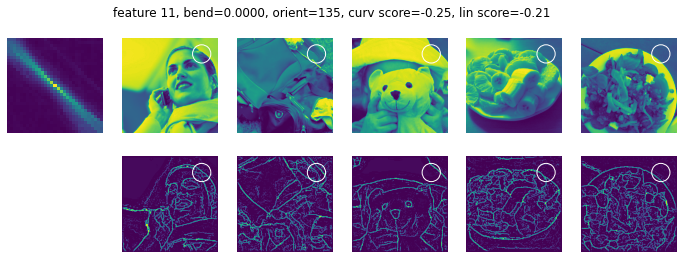

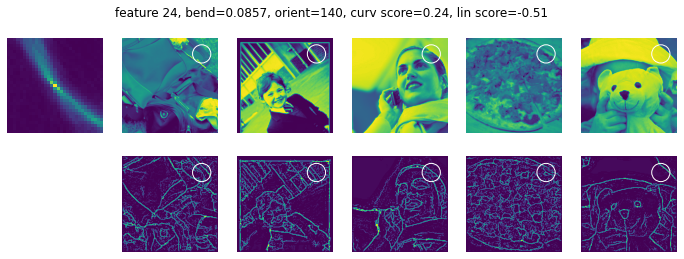

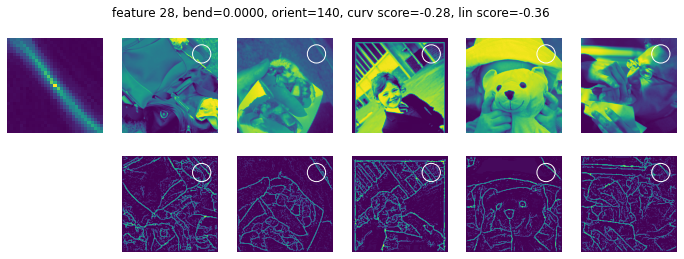

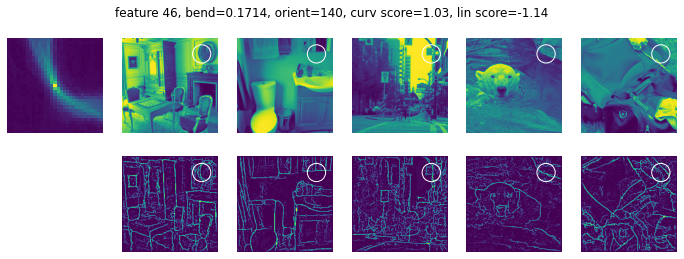

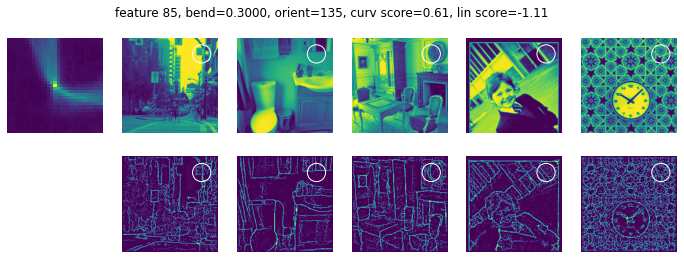

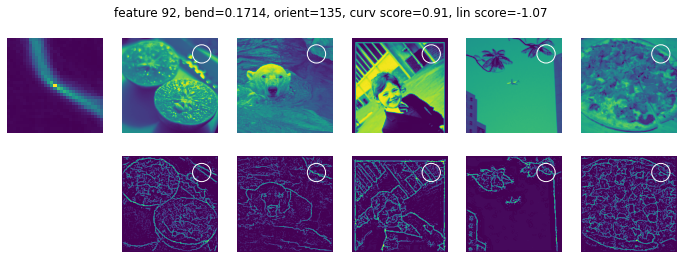

In [66]:
features_to_plot = np.where(np.abs(estim_orient_values-135)<=10)[0]
plot_top_ims(features_to_plot)

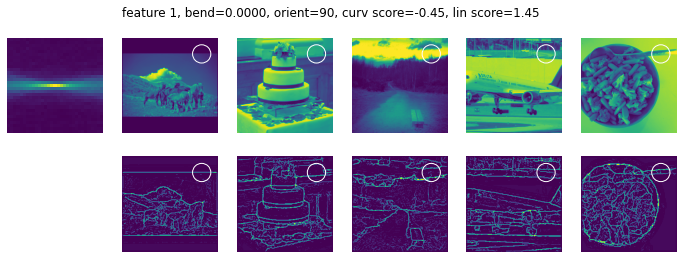

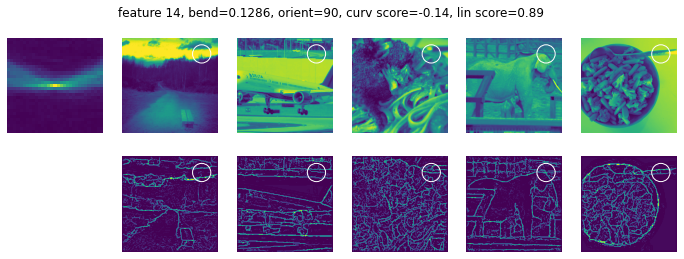

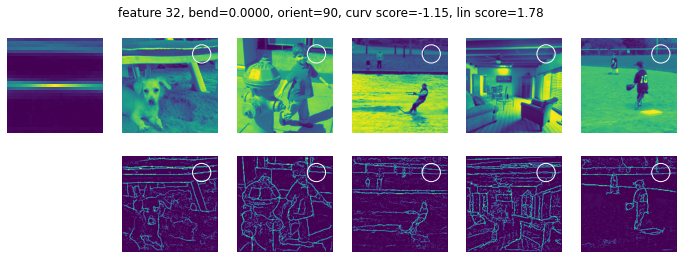

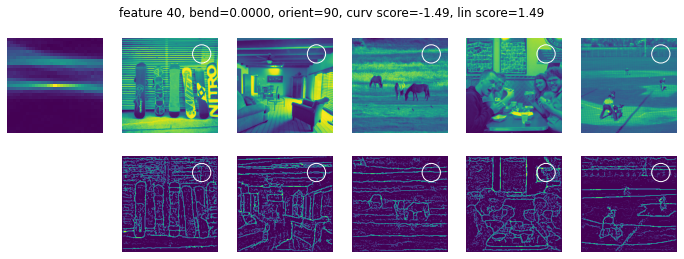

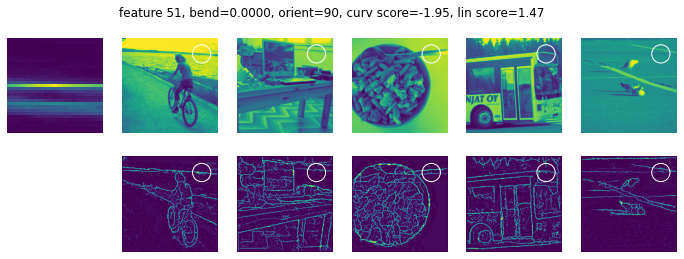

...

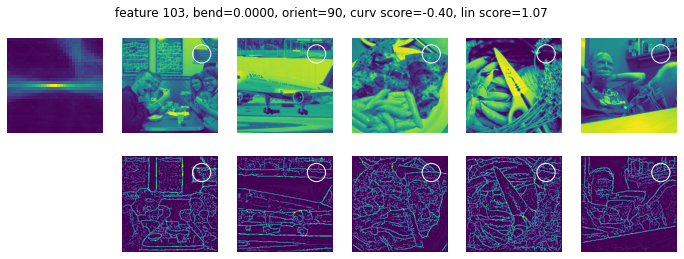

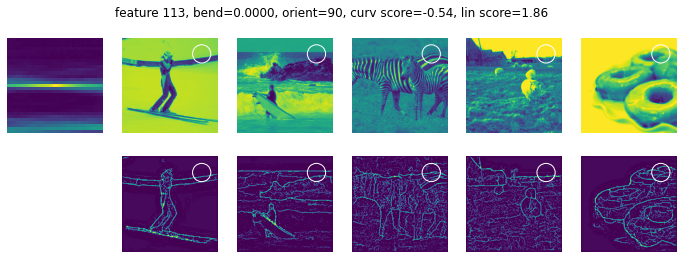

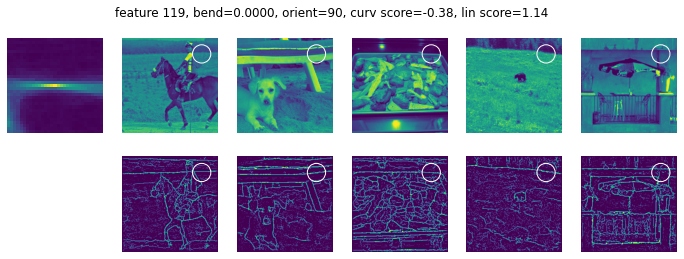

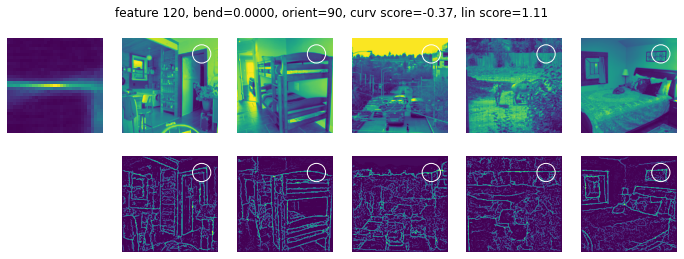

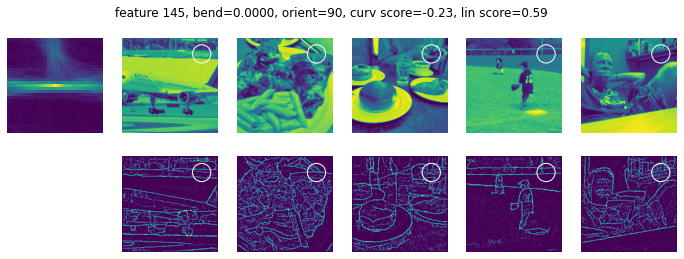

In [67]:
features_to_plot = np.where(estim_orient_values==90)[0]
plot_top_ims(features_to_plot)

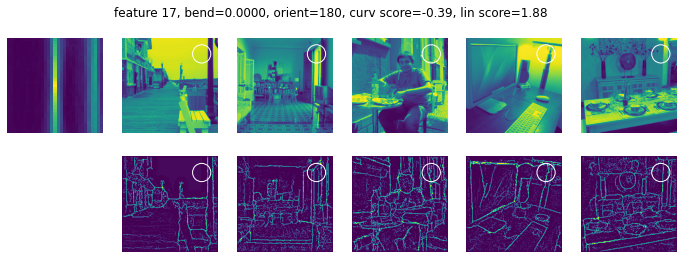

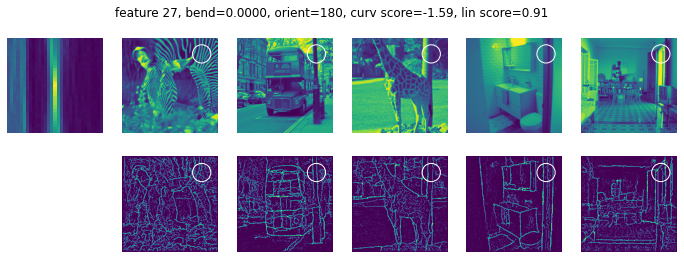

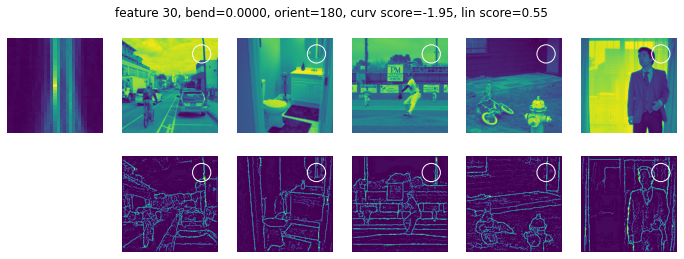

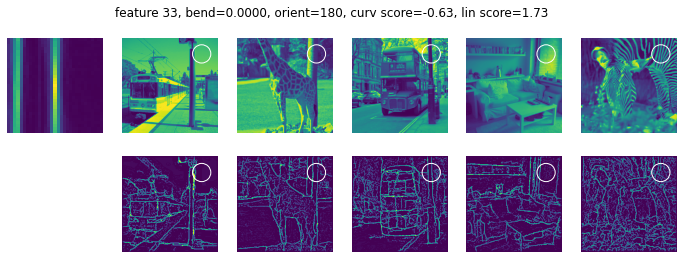

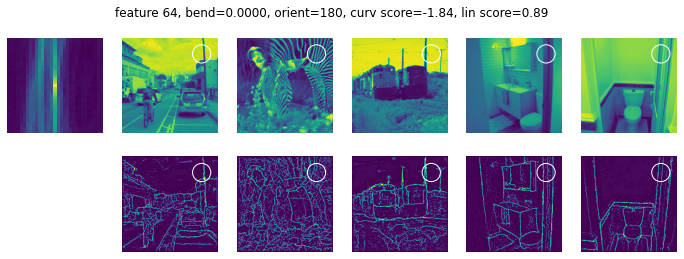

...

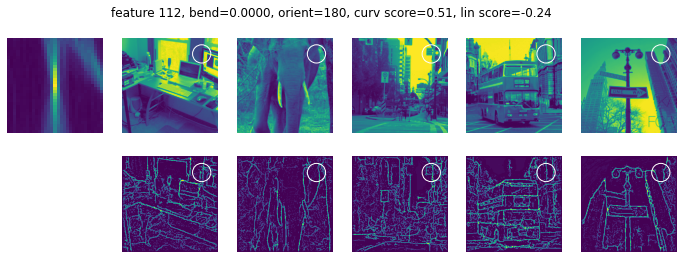

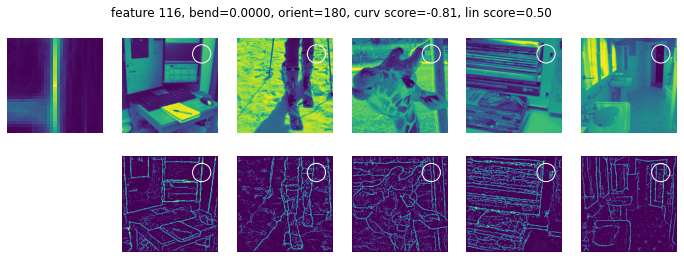

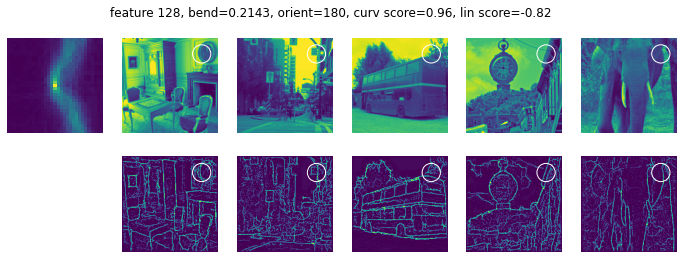

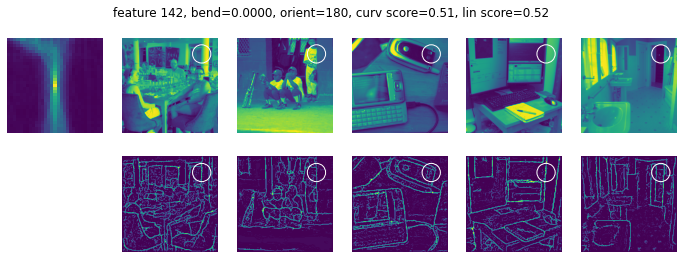

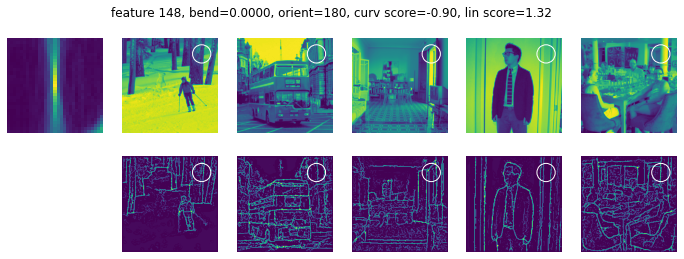

In [68]:
features_to_plot = np.where(estim_orient_values==180)[0]
plot_top_ims(features_to_plot)

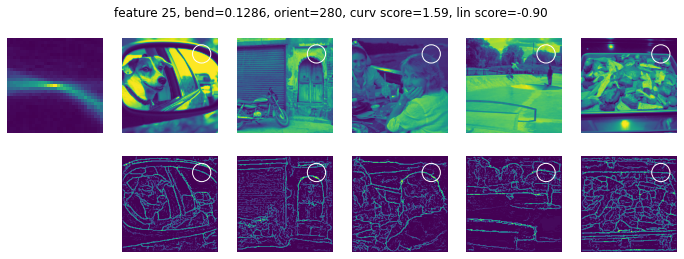

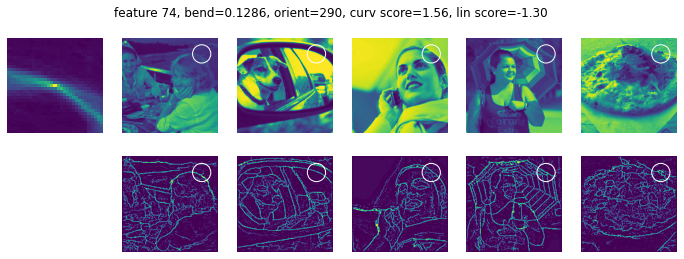

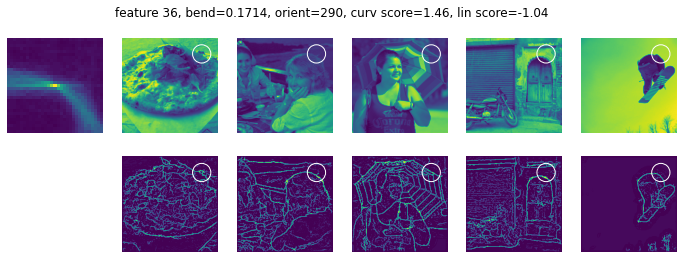

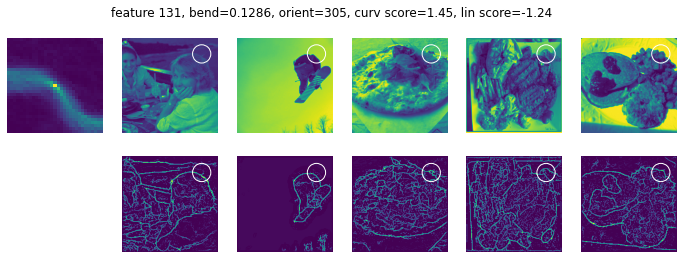

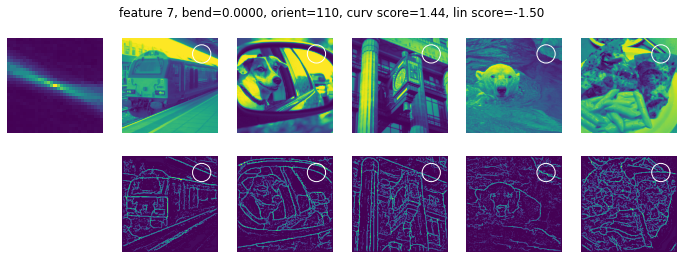

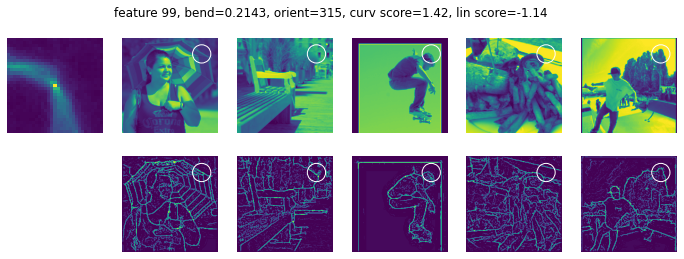

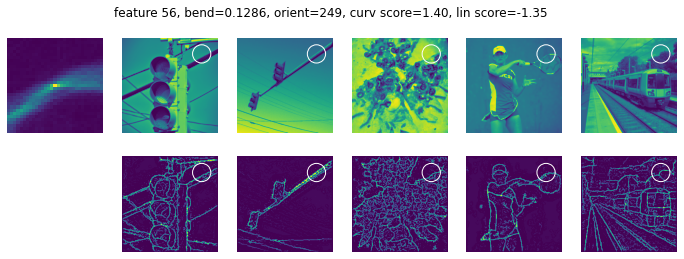

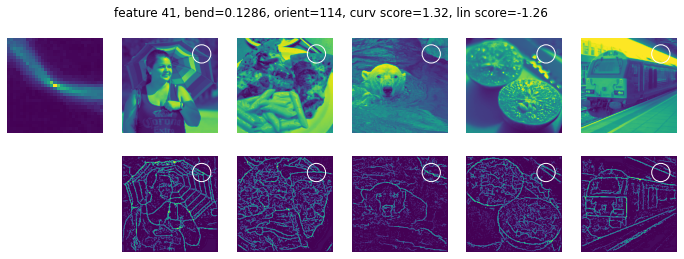

In [69]:
features_to_plot = np.flip(np.argsort(curv_score))[0:8]
plot_top_ims(features_to_plot)

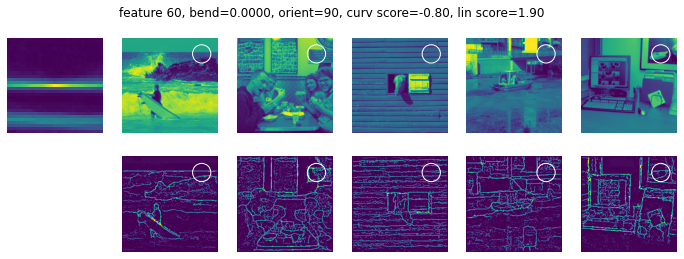

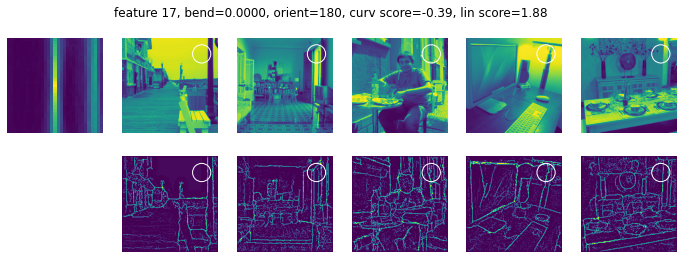

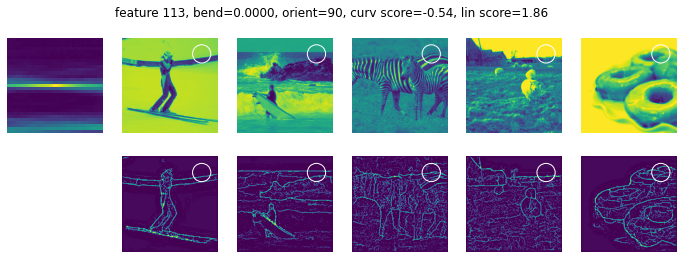

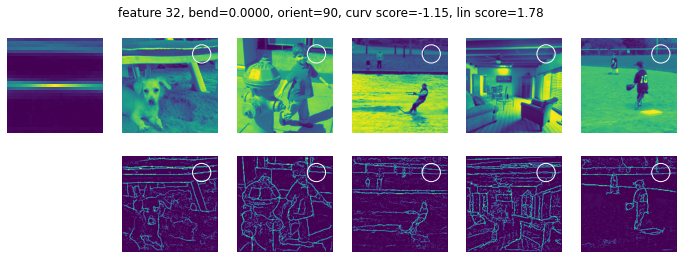

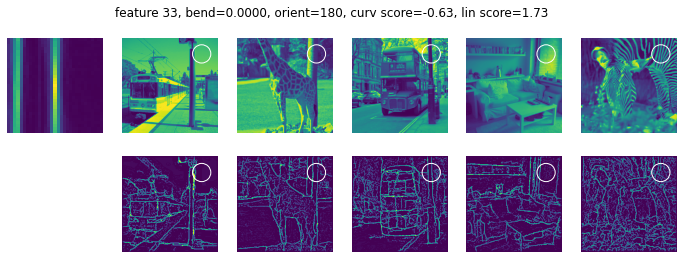

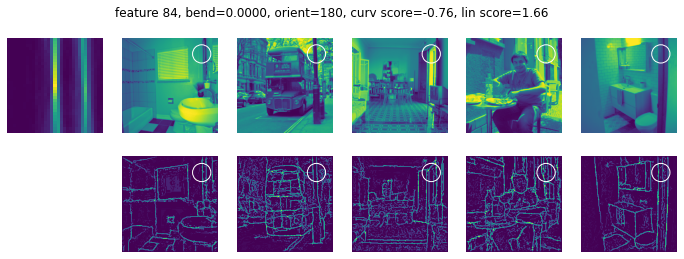

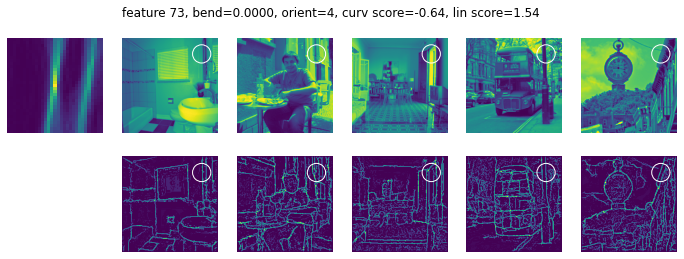

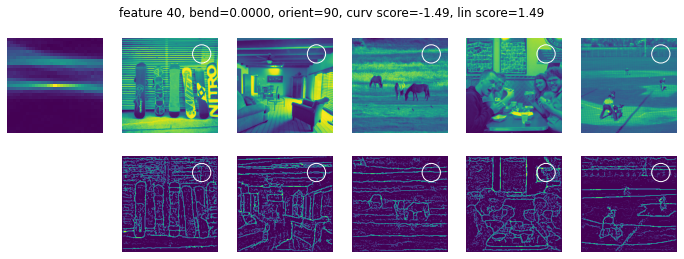

In [70]:
features_to_plot = np.flip(np.argsort(lin_score))[0:8]
plot_top_ims(features_to_plot)

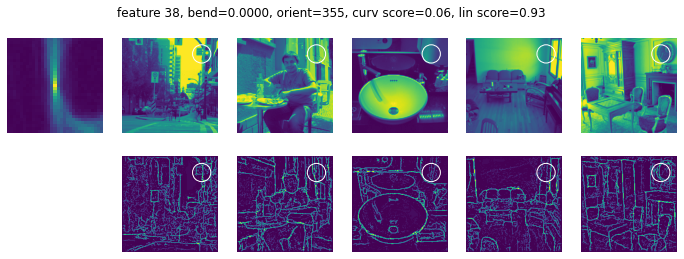

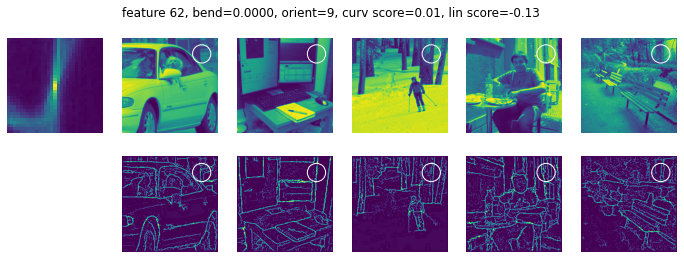

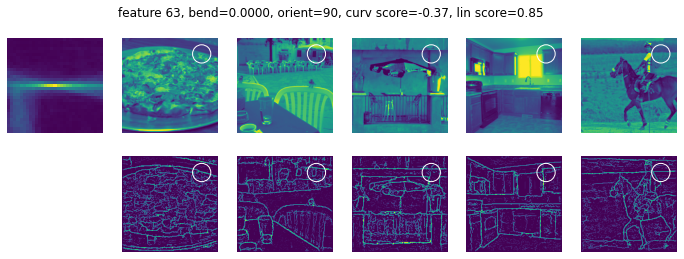

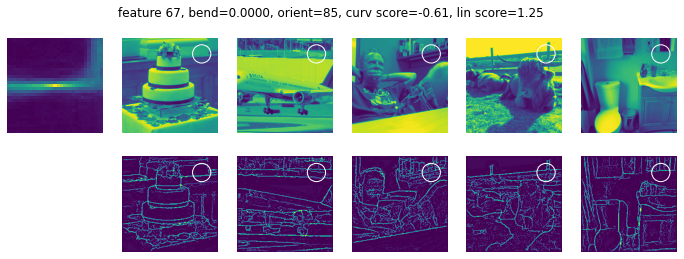

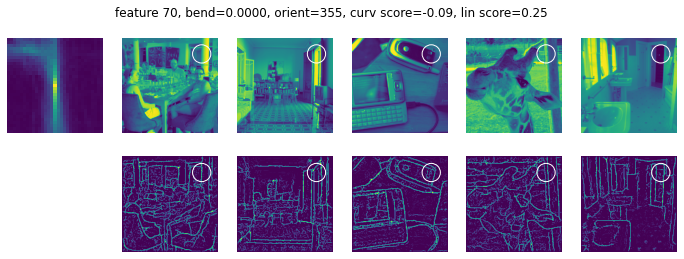

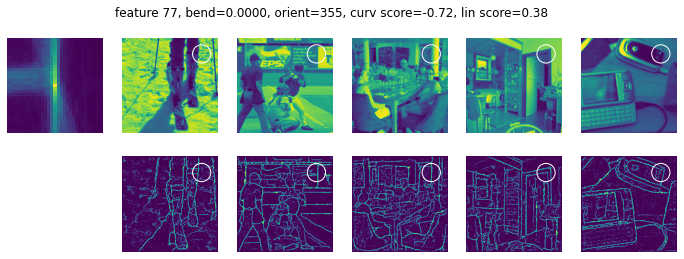

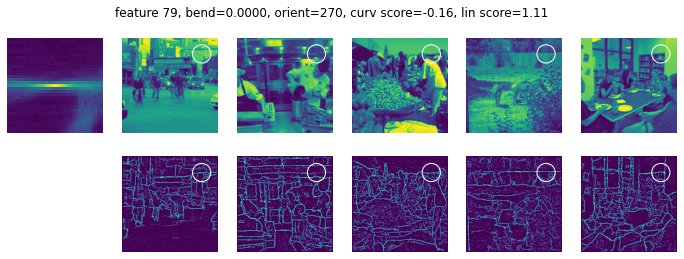

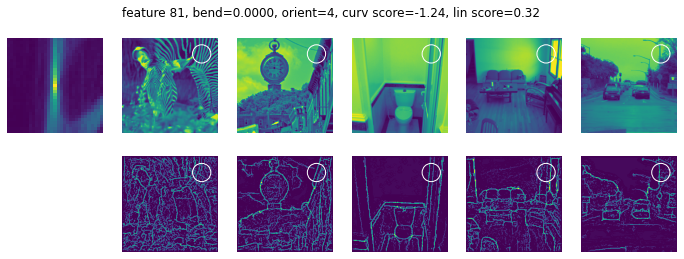

In [71]:
features_to_plot = np.where(is_junction)[0][0:8]
plot_top_ims(features_to_plot)

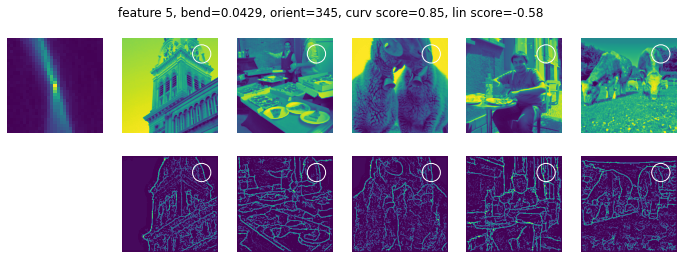

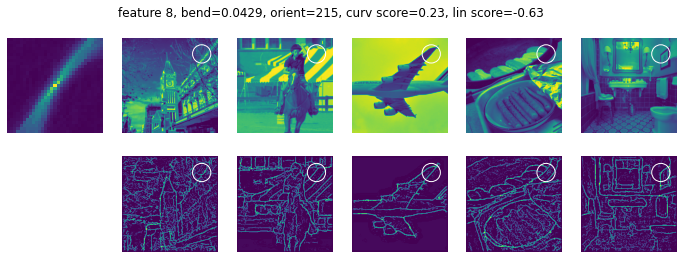

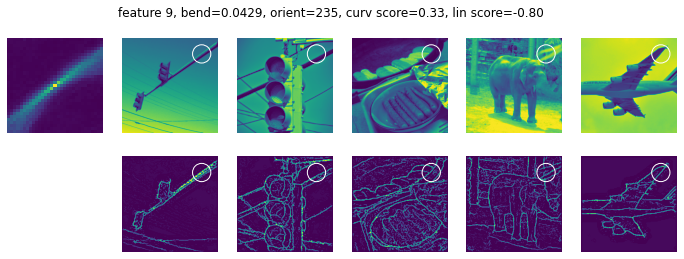

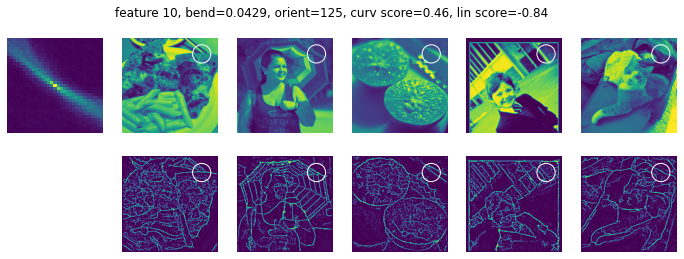

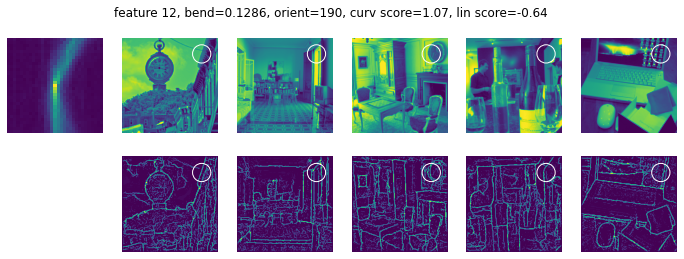

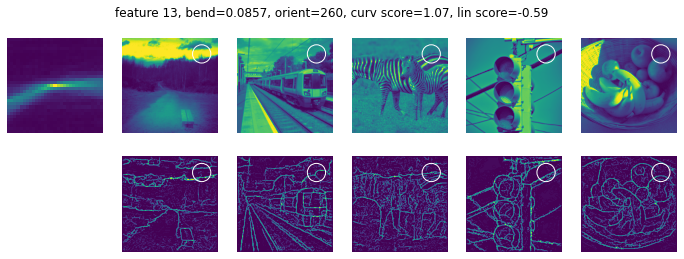

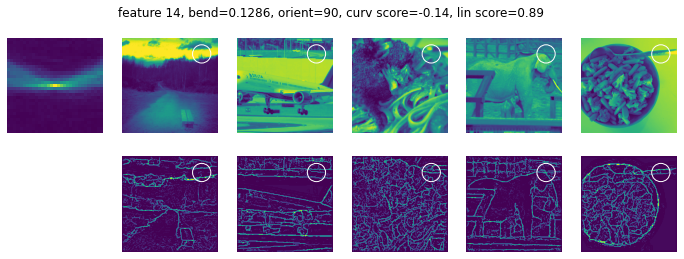

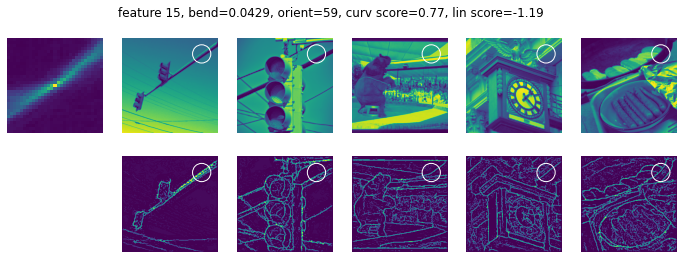

In [72]:
features_to_plot = np.where((is_single) & (estim_bend_values>0))[0][0:8]
plot_top_ims(features_to_plot)

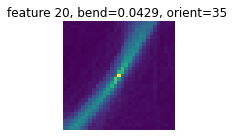

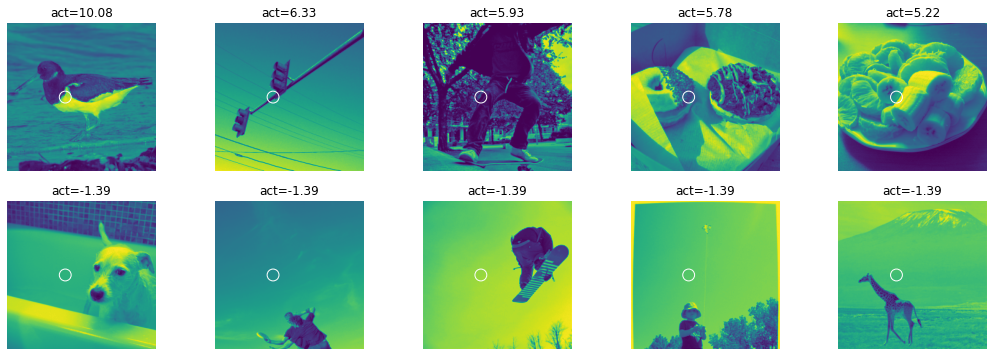

In [12]:
ff = 20
zvals = scipy.stats.zscore(feat[:,ff])

plt.figure(figsize=(2,2));
plt.pcolormesh(feature_ims[:,:,ff])
plt.gca().invert_yaxis()
plt.axis('off')
# plt.axis('square')
plt.suptitle('feature %d, bend=%.4f, orient=%d'%(ff, \
                     estim_bend_values[ff], estim_orient_values[ff]))

top_n = 5
top_images = np.flip(np.argsort(zvals))[0:top_n]
bottom_images = np.argsort(zvals)[0:top_n]
top_resp = zvals[top_images]
bottom_resp = zvals[bottom_images]
top_images = image_data[top_images,0,:,:]
bottom_images = image_data[bottom_images,0,:,:]

center_in_image = np.array((n_pix/2 + x*n_pix, n_pix/2 - n_pix*y))
size_in_image = 2*sigma*n_pix

plt.figure(figsize=(18,6));
for ii in range(top_n):
    ax = plt.subplot(2,top_n,ii+1);
    plt.imshow(top_images[ii,:,:])
    circ = matplotlib.patches.Circle(center_in_image, size_in_image, 
                                                 color = 'w', fill=False)
    ax.add_artist(circ)
    plt.axis('off')
    plt.title('act=%.2f'%top_resp[ii])
    
for ii in range(top_n):
    ax = plt.subplot(2,top_n,ii+1+top_n);    
    plt.imshow(bottom_images[ii,:,:])
    circ = matplotlib.patches.Circle(center_in_image, size_in_image, 
                                                 color = 'w', fill=False)
    ax.add_artist(circ)
    plt.axis('off')
    plt.title('act=%.2f'%bottom_resp[ii])
 